# Eager Few Shot Object Detection Colab

Welcome to the Eager Few Shot Object Detection Colab --- in this colab we demonstrate fine tuning of a (TF2 friendly) RetinaNet architecture on very few examples of a novel class after initializing from a pre-trained COCO checkpoint.
Training runs in eager mode.

Estimated time to run through this colab (with GPU): < 5 minutes.

## Imports

In [ ]:
!pip install -U --pre tensorflow=="2.2.0"

  Using cached https://files.pythonhosted.org/packages/3d/be/679ce5254a8c8d07470efb4a4c00345fae91f766e64f1c2aece8796d7218/tensorflow-2.2.0-cp36-cp36m-manylinux2010_x86_64.whl
  Using cached https://files.pythonhosted.org/packages/1d/74/0a6fcb206dcc72a6da9a62dd81784bfdbff5fedb099982861dc2219014fb/tensorboard-2.2.2-py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/a4/f5/926ae53d6a226ec0fda5208e0e581cffed895ccc89e36ba76a8e60895b78/tensorflow_estimator-2.2.0-py2.py3-none-any.whl
ERROR: tf-models-official 2.3.0 has requirement tensorflow>=2.3.0, but you'll have tensorflow 2.2.0 which is incompatible.
  Found existing installation: tensorboard 2.3.0
    Uninstalling tensorboard-2.3.0:
      Successfully uninstalled tensorboard-2.3.0
  Found existing installation: tensorflow-estimator 2.3.0
    Uninstalling tensorflow-estimator-2.3.0:
      Successfully uninstalled tensorflow-estimator-2.3.0
  Found existing installation: tensorflow 2.3.0
    Uninstalling tensorflow-2.3.

In [ ]:
import os
import pathlib

# Clone the tensorflow models repository if it doesn't already exist
if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')
elif not pathlib.Path('models').exists():
  !git clone --depth 1 https://github.com/tensorflow/models

In [ ]:
# Install the Object Detection API
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Using cached https://files.pythonhosted.org/packages/97/ae/0b08f53498417914f2274cc3b5576d2b83179b0cbb209457d0fde0152174/tensorflow-2.3.0-cp36-cp36m-manylinux2010_x86_64.whl
  Using cached https://files.pythonhosted.org/packages/e9/1b/6a420d7e6ba431cf3d51b2a5bfa06a958c4141e3189385963dc7f6fbffb6/tensorboard-2.3.0-py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/e9/ed/5853ec0ae380cba4588eab1524e18ece1583b65f7ae0e97321f5ff9dfd60/tensorflow_estimator-2.3.0-py2.py3-none-any.whl
  Created wheel for object-detection: filename=object_detection-0.1-cp36-none-any.whl size=1550887 sha256=c3030c23b045c2137c03772f0115ea3e25271b29baea5a7b719d01762573a6aa
  Stored in directory: /tmp/pip-ephem-wheel-cache-ojgku174/wheels/94/49/4b/39b051683087a22ef7e80ec52152a27249d1a644ccf4e442ea
Successfully built object-detection
  Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-

In [ ]:
import matplotlib
import matplotlib.pyplot as plt

import os
import random
import io
import imageio
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import colab_utils
from object_detection.builders import model_builder

%matplotlib inline

# Utilities

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path.

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

def plot_detections(image_np,
                    boxes,
                    classes,
                    scores,
                    category_index,
                    figsize=(12, 16),
                    image_name=None):
  """Wrapper function to visualize detections.

  Args:
    image_np: uint8 numpy array with shape (img_height, img_width, 3)
    boxes: a numpy array of shape [N, 4]
    classes: a numpy array of shape [N]. Note that class indices are 1-based,
      and match the keys in the label map.
    scores: a numpy array of shape [N] or None.  If scores=None, then
      this function assumes that the boxes to be plotted are groundtruth
      boxes and plot all boxes as black with no classes or scores.
    category_index: a dict containing category dictionaries (each holding
      category index `id` and category name `name`) keyed by category indices.
    figsize: size for the figure.
    image_name: a name for the image file.
  """
  image_np_with_annotations = image_np.copy()
  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_annotations,
      boxes,
      classes,
      scores,
      category_index,
      use_normalized_coordinates=True,
      min_score_thresh=0.8)
  if image_name:
    plt.imsave(image_name, image_np_with_annotations)
  else:
    plt.imshow(image_np_with_annotations)


In [ ]:

# def load_image_into_numpy_array(path):
#   """Load an image from file into a numpy array.

#   Puts image into numpy array to feed into tensorflow graph.
#   Note that by convention we put it into a numpy array with shape
#   (height, width, channels), where channels=3 for RGB.

#   Args:
#     path: a file path.

#   Returns:
#     uint8 numpy array with shape (img_height, img_width, 3)
#   """
#   img_data = tf.io.gfile.GFile(path, 'rb').read()
#   image = Image.open(BytesIO(img_data))
#   print("image size: ", image.size)
#   (im_width, im_height) = image.size
#   image= image.resize((640, 480))
#   return np.array(image.getdata()).reshape((
#       640,480, 3)).astype(np.uint8)

# def load_img2np(path):

#     image = cv2.imread(path)
#     # 이미지를 BGR 형식에서 RGB 형식으로 변환

#     # op1) color image
#     image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#     # op2) gray scale image
#     # image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
#     # 이미지 축소 (select min pixel)
#     image = cv2.resize(image, (640, 640), interpolation=cv2.INTER_AREA)
#     # 이미지 numpy 배열(RGB 이미지)
#     return np.array(image)

# def plot_detections(image_np,
#                     boxes,
#                     classes,
#                     scores,
#                     category_index,
#                     figsize=(12, 16),
#                     image_name=None):
#   """Wrapper function to visualize detections.

#   Args:
#     image_np: uint8 numpy array with shape (img_height, img_width, 3)
#     boxes: a numpy array of shape [N, 4]
#     classes: a numpy array of shape [N]. Note that class indices are 1-based,
#       and match the keys in the label map.
#     scores: a numpy array of shape [N] or None.  If scores=None, then
#       this function assumes that the boxes to be plotted are groundtruth
#       boxes and plot all boxes as black with no classes or scores.
#     category_index: a dict containing category dictionaries (each holding
#       category index `id` and category name `name`) keyed by category indices.
#     figsize: size for the figure.
#     image_name: a name for the image file.
#   """
# #   image_np_with_annotations = image_np.copy()
#   image_np_with_annotations = image_np
#   viz_utils.visualize_boxes_and_labels_on_image_array(
#       image_np_with_annotations,
#       boxes,
#       classes,
#       scores,
#       category_index,
#       use_normalized_coordinates=True,
#       min_score_thresh=0.8)
#   if image_name:
#     plt.imsave(image_name, image_np_with_annotations)
#   else:
#     plt.imshow(image_np_with_annotations)


# Rubber Ducky data

We will start with some toy (literally) data consisting of 5 images of a rubber
ducky.  Note that the [coco](https://cocodataset.org/#explore) dataset contains a number of animals, but notably, it does *not* contain rubber duckies (or even ducks for that matter), so this is a novel class.

In [ ]:
from google.colab import drive
import os
# import glob

drive.mount('/content/drive')

path = "/content/drive/My Drive/supergate/data/detect_target/"
file_list = os.listdir(path)
# file_list = glob.glob(path)
file_list_img = sorted([file for file in file_list if file.endswith(".JPG")])
print ("file_list_img: {}".format(file_list_img))

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
file_list_img: ['target1.JPG', 'target12.JPG', 'target13.JPG', 'target14.JPG', 'target15.JPG', 'target16.JPG', 'target17.JPG', 'target18.JPG', 'target19.JPG', 'target2.JPG', 'target20.JPG', 'target21.JPG', 'target22.JPG', 'target23.JPG', 'target24.JPG', 'target25.JPG', 'target26.JPG', 'target27.JPG', 'target28.JPG']


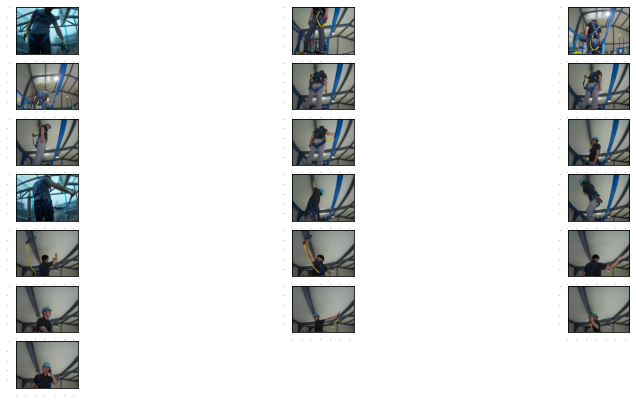

In [ ]:
# Load images and visualize
train_images_np = []
for image_path in file_list_img :
  train_images_np.append(load_image_into_numpy_array(path+image_path))
#   train_images_np.append(load_img2np(path+image_path))


plt.rcParams['axes.grid'] = False
plt.rcParams['xtick.labelsize'] = False
plt.rcParams['ytick.labelsize'] = False
plt.rcParams['xtick.top'] = False
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False
plt.rcParams['ytick.right'] = False
plt.rcParams['figure.figsize'] = [14, 7]

for idx, train_image_np in enumerate(train_images_np):
  plt.subplot(len(file_list_img)//3+1, 3, idx+1)
  plt.imshow(train_image_np)
plt.show()

# Annotate images with bounding boxes

In this cell you will annotate the rubber duckies --- draw a box around the rubber ducky in each image; click `next image` to go to the next image and `submit` when there are no more images.

If you'd like to skip the manual annotation step, we totally understand.  In this case, simply skip this cell and run the next cell instead, where we've prepopulated the groundtruth with pre-annotated bounding boxes.



In [ ]:
gt_boxes = []
colab_utils.annotate(train_images_np, box_storage_pointer=gt_boxes)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

'--boxes array populated--'

<IPython.core.display.Javascript object>

# In case you didn't want to label...

Run this cell only if you didn't annotate anything above and
would prefer to just use our preannotated boxes.  Don't forget
to uncomment.

In [ ]:
# gt_boxes = [
#             np.array([[0.436, 0.591, 0.629, 0.712]], dtype=np.float32),
#             np.array([[0.539, 0.583, 0.73, 0.71]], dtype=np.float32),
#             np.array([[0.464, 0.414, 0.626, 0.548]], dtype=np.float32),
#             np.array([[0.313, 0.308, 0.648, 0.526]], dtype=np.float32),
#             np.array([[0.256, 0.444, 0.484, 0.629]], dtype=np.float32)
# ]
from numpy import array
gt_boxes = [
 array([[0.80111111, 0.7203125 , 0.99611111, 0.8453125 ]], dtype=np.float32),
 array([[0.68277778, 0.2484375 , 0.94444444, 0.3640625 ]], dtype=np.float32),
 array([[0.66777778, 0.4734375 , 0.85777778, 0.5203125 ]], dtype=np.float32),
 array([[0.90611111, 0.4015625 , 0.99611111, 0.471875  ]], dtype=np.float32),
 array([[0.09277778, 0.3328125 , 0.15777778, 0.4328125 ]], dtype=np.float32),
 array([[0.09111111, 0.3359375 , 0.15611111, 0.4265625 ]], dtype=np.float32),
 array([[0.08777778, 0.3296875 , 0.15277778, 0.4234375 ]], dtype=np.float32),
 array([[0.28277778, 0.66875   , 0.41111111, 0.7125    ]], dtype=np.float32),
 array([[0.49111111, 0.3453125 , 0.56944444, 0.4015625 ]], dtype=np.float32),
 array([[0.29944444, 0.8625    , 0.48777778, 0.965625  ]], dtype=np.float32),
 array([[0.75777778, 0.28125   , 0.98277778, 0.39375   ]], dtype=np.float32),
 array([[0.46277778, 0.4203125 , 0.62944444, 0.5203125 ]], dtype=np.float32),
 array([[0.14111111, 0.159375  , 0.32777778, 0.3296875 ]], dtype=np.float32),
 array([[0.11444444, 0.1671875 , 0.31611111, 0.325     ]], dtype=np.float32),
 array([[0.49611111, 0.8046875 , 0.70944444, 0.8890625 ]], dtype=np.float32),
 array([[0.59111111, 0.3140625 , 0.67111111, 0.384375  ]], dtype=np.float32),
 array([[0.52944444, 0.7296875 , 0.69611111, 0.7875    ]], dtype=np.float32),
 array([[0.56444444, 0.3234375 , 0.80611111, 0.40625   ]], dtype=np.float32),
 array([[0.57944444, 0.3078125 , 0.65611111, 0.38125   ]], dtype=np.float32)
 ]


# Prepare data for training

Below we add the class annotations (for simplicity, we assume a single class in this colab; though it should be straightforward to extend this to handle multiple classes).  We also convert everything to the format that the training
loop below expects (e.g., everything converted to tensors, classes converted to one-hot representations, etc.).

In [ ]:

# By convention, our non-background classes start counting at 1.  Given
# that we will be predicting just one class, we will therefore assign it a
# `class id` of 1.
duck_class_id = 1
num_classes = 1

category_index = {duck_class_id: {'id': duck_class_id, 'name': 'rubber_ducky'}}

# Convert class labels to one-hot; convert everything to tensors.
# The `label_id_offset` here shifts all classes by a certain number of indices;
# we do this here so that the model receives one-hot labels where non-background
# classes start counting at the zeroth index.  This is ordinarily just handled
# automatically in our training binaries, but we need to reproduce it here.
label_id_offset = 1
train_image_tensors = []
gt_classes_one_hot_tensors = []
gt_box_tensors = []
for (train_image_np, gt_box_np) in zip(
    train_images_np, gt_boxes):
  train_image_tensors.append(tf.expand_dims(tf.convert_to_tensor(
      train_image_np, dtype=tf.float32), axis=0))
  gt_box_tensors.append(tf.convert_to_tensor(gt_box_np, dtype=tf.float32))
  zero_indexed_groundtruth_classes = tf.convert_to_tensor(
      np.ones(shape=[gt_box_np.shape[0]], dtype=np.int32) - label_id_offset)
  gt_classes_one_hot_tensors.append(tf.one_hot(
      zero_indexed_groundtruth_classes, num_classes))
print('Done prepping data.')


Done prepping data.


# Let's just visualize the rubber duckies as a sanity check


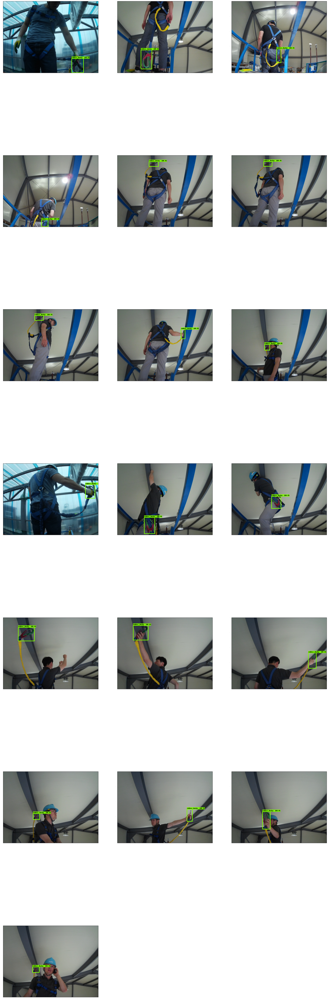

In [ ]:
dummy_scores = np.array([1.0], dtype=np.float32)  # give boxes a score of 100%

plt.figure(figsize=(30, 100))
len_img=len(train_images_np)
for idx in range(len_img):
  plt.subplot(len_img//3+1, 3, idx+1)
  plot_detections(
      train_images_np[idx],
      gt_boxes[idx],
      np.ones(shape=[gt_boxes[idx].shape[0]]
      , dtype=np.int32),
      dummy_scores,
    category_index)
plt.show()

# Create model and restore weights for all but last layer

In this cell we build a single stage detection architecture (RetinaNet) and restore all but the classification layer at the top (which will be automatically randomly initialized).

For simplicity, we have hardcoded a number of things in this colab for the specific RetinaNet architecture at hand (including assuming that the image size will always be 640x640), however it is not difficult to generalize to other model configurations.

In [ ]:
# Download the checkpoint and put it into models/research/object_detection/test_data/

!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
!tar -xf ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
!mv ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint models/research/object_detection/test_data/

--2020-08-21 05:44:34--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.217.212.128, 2607:f8b0:4001:c14::80
Connecting to download.tensorflow.org (download.tensorflow.org)|172.217.212.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 244817203 (233M) [application/x-tar]
Saving to: ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz.3’

ssd_resnet50_v1_fpn 100%[===================>] 233.48M   182MB/s    in 1.3s    

2020-08-21 05:44:35 (182 MB/s) - ‘ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz.3’ saved [244817203/244817203]

mv: cannot move 'ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/checkpoint' to 'models/research/object_detection/test_data/checkpoint': Directory not empty


In [ ]:
tf.keras.backend.clear_session()

print('Building model and restoring weights for fine-tuning...', flush=True)
num_classes = 1
pipeline_config = 'models/research/object_detection/configs/tf2/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.config'
checkpoint_path = 'models/research/object_detection/test_data/checkpoint/ckpt-0'

# Load pipeline config and build a detection model.
#
# Since we are working off of a COCO architecture which predicts 90
# class slots by default, we override the `num_classes` field here to be just
# one (for our new rubber ducky class).
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
model_config.ssd.num_classes = num_classes
model_config.ssd.freeze_batchnorm = True
detection_model = model_builder.build(
      model_config=model_config, is_training=True)

# Set up object-based checkpoint restore --- RetinaNet has two prediction
# `heads` --- one for classification, the other for box regression.  We will
# restore the box regression head but initialize the classification head
# from scratch (we show the omission below by commenting out the line that
# we would add if we wanted to restore both heads)
fake_box_predictor = tf.compat.v2.train.Checkpoint(
    _base_tower_layers_for_heads=detection_model._box_predictor._base_tower_layers_for_heads,
    # _prediction_heads=detection_model._box_predictor._prediction_heads,
    #    (i.e., the classification head that we *will not* restore)
    _box_prediction_head=detection_model._box_predictor._box_prediction_head,
    )
fake_model = tf.compat.v2.train.Checkpoint(
          _feature_extractor=detection_model._feature_extractor,
          _box_predictor=fake_box_predictor)
ckpt = tf.compat.v2.train.Checkpoint(model=fake_model)
ckpt.restore(checkpoint_path).expect_partial()

# Run model through a dummy image so that variables are created
image, shapes = detection_model.preprocess(tf.zeros([1, 480, 640, 3]))
prediction_dict = detection_model.predict(image, shapes)
_ = detection_model.postprocess(prediction_dict, shapes)
print('Weights restored!')

Building model and restoring weights for fine-tuning...
Weights restored!


# Eager mode custom training loop



In [ ]:
tf.keras.backend.set_learning_phase(True)

# These parameters can be tuned; since our training set has 5 images
# it doesn't make sense to have a much larger batch size, though we could
# fit more examples in memory if we wanted to.
batch_size = 18
learning_rate = 0.01
num_batches = 100

# Select variables in top layers to fine-tune.
trainable_variables = detection_model.trainable_variables
to_fine_tune = []
prefixes_to_train = [
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalBoxHead',
  'WeightSharedConvolutionalBoxPredictor/WeightSharedConvolutionalClassHead']
for var in trainable_variables:
  if any([var.name.startswith(prefix) for prefix in prefixes_to_train]):
    to_fine_tune.append(var)

# Set up forward + backward pass for a single train step.
def get_model_train_step_function(model, optimizer, vars_to_fine_tune):
  """Get a tf.function for training step."""

  # Use tf.function for a bit of speed.
  # Comment out the tf.function decorator if you want the inside of the
  # function to run eagerly.
  @tf.function
  def train_step_fn(image_tensors,
                    groundtruth_boxes_list,
                    groundtruth_classes_list):
    """A single training iteration.

    Args:
      image_tensors: A list of [1, height, width, 3] Tensor of type tf.float32.
        Note that the height and width can vary across images, as they are
        reshaped within this function to be 640x640.
      groundtruth_boxes_list: A list of Tensors of shape [N_i, 4] with type
        tf.float32 representing groundtruth boxes for each image in the batch.
      groundtruth_classes_list: A list of Tensors of shape [N_i, num_classes]
        with type tf.float32 representing groundtruth boxes for each image in
        the batch.

    Returns:
      A scalar tensor representing the total loss for the input batch.
    """
    shapes = tf.constant(batch_size * [[480, 640, 3]], dtype=tf.int32)
    model.provide_groundtruth(
        groundtruth_boxes_list=groundtruth_boxes_list,
        groundtruth_classes_list=groundtruth_classes_list)
    with tf.GradientTape() as tape:
      preprocessed_images = tf.concat(
          [detection_model.preprocess(image_tensor)[0]
           for image_tensor in image_tensors], axis=0)
      prediction_dict = model.predict(preprocessed_images, shapes)
      losses_dict = model.loss(prediction_dict, shapes)
      total_loss = losses_dict['Loss/localization_loss'] + losses_dict['Loss/classification_loss']
      gradients = tape.gradient(total_loss, vars_to_fine_tune)
      optimizer.apply_gradients(zip(gradients, vars_to_fine_tune))
    return total_loss

  return train_step_fn

optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9)
train_step_fn = get_model_train_step_function(
    detection_model, optimizer, to_fine_tune)

print('Start fine-tuning!', flush=True)
for idx in range(num_batches):
  # Grab keys for a random subset of examples
  all_keys = list(range(len(train_images_np)))
  random.shuffle(all_keys)
  example_keys = all_keys[:batch_size]

  # Note that we do not do data augmentation in this demo.  If you want a
  # a fun exercise, we recommend experimenting with random horizontal flipping
  # and random cropping :)
  gt_boxes_list = [gt_box_tensors[key] for key in example_keys]
  gt_classes_list = [gt_classes_one_hot_tensors[key] for key in example_keys]
  image_tensors = [train_image_tensors[key] for key in example_keys]

  # Training step (forward pass + backwards pass)
  total_loss = train_step_fn(image_tensors, gt_boxes_list, gt_classes_list)

  if idx % 10 == 0:
    print('batch ' + str(idx) + ' of ' + str(num_batches)
    + ', loss=' +  str(total_loss.numpy()), flush=True)

print('Done fine-tuning!')

Start fine-tuning!
batch 0 of 100, loss=0.039191294
batch 10 of 100, loss=0.038391218
batch 20 of 100, loss=0.03666515
batch 30 of 100, loss=0.03589017
batch 40 of 100, loss=0.0348525
batch 50 of 100, loss=0.0347713
batch 60 of 100, loss=0.032682408
batch 70 of 100, loss=0.030844742
batch 80 of 100, loss=0.030441418
batch 90 of 100, loss=0.029143063
Done fine-tuning!


In [ ]:
gt_classes_list

[<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[1.]], dtype=float32)>,
 <tf.Tensor: shape=(1, 1), dtype=float32, numpy=arra

# Load test images and run inference with new model!

Tensor("input_tensor:0", shape=(1, 480, 640, 3), dtype=float32)


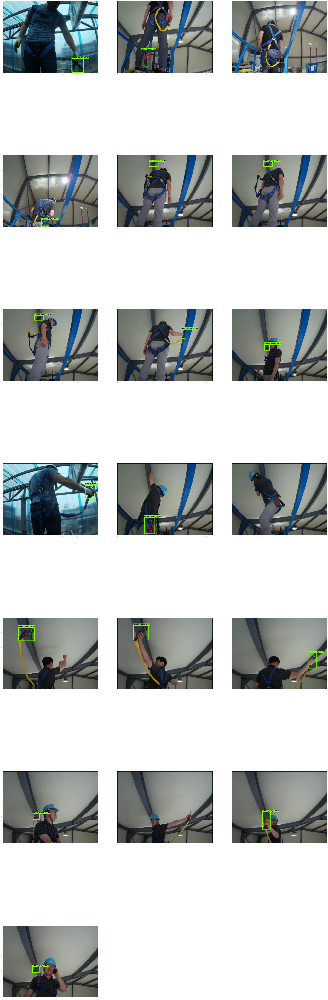

In [ ]:
# test_image_dir = 'models/research/object_detection/test_images/ducky/test/'
# test_images_np = []
# for i in range(1, 50):
#   image_path = os.path.join(test_image_dir, 'out' + str(i) + '.jpg')
#   test_images_np.append(np.expand_dims(
#       load_image_into_numpy_array(image_path), axis=0))

test_images_np = []
path = "/content/drive/My Drive/supergate/data/detect_target/"

file_list = os.listdir(path)
file_list_img = sorted([file for file in file_list if file.endswith(".JPG")])
for image_path in file_list_img:
    test_images_np.append(np.expand_dims(load_image_into_numpy_array(path+image_path), axis=0))


# Again, uncomment this decorator if you want to run inference eagerly
@tf.function
def detect(input_tensor):
  """Run detection on an input image.

  Args:
    input_tensor: A [1, height, width, 3] Tensor of type tf.float32.
      Note that height and width can be anything since the image will be
      immediately resized according to the needs of the model within this
      function.

  Returns:
    A dict containing 3 Tensors (`detection_boxes`, `detection_classes`,
      and `detection_scores`).
  """
  print(input_tensor)
  preprocessed_image, shapes = detection_model.preprocess(input_tensor)
  prediction_dict = detection_model.predict(preprocessed_image, shapes)
  return detection_model.postprocess(prediction_dict, shapes)

# Note that the first frame will trigger tracing of the tf.function, which will
# take some time, after which inference should be fast.

label_id_offset = 1

plt.figure(figsize=(30, 100))
len_img=len(test_images_np)
for i in range(len_img):
  input_tensor = tf.convert_to_tensor(test_images_np[i], dtype=tf.float32)
  detections = detect(input_tensor)
  plt.subplot(len_img//3+1, 3, i+1)
  plot_detections(
      test_images_np[i][0],
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.uint32)
      + label_id_offset,
      detections['detection_scores'][0].numpy(),
      category_index, figsize=(15, 20))
    #   image_name="gif_frame_" + ('%02d' % i) + ".jpg")
plt.show()


Tensor("input_tensor:0", shape=(1, 480, 640, 3), dtype=float32)
Tensor("input_tensor:0", shape=(1, 3024, 4032, 3), dtype=float32)


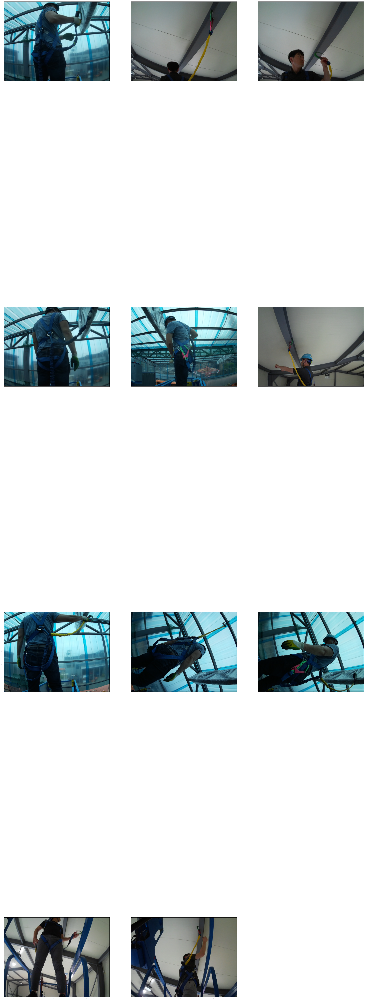

In [ ]:

test_images_np = []
path = "/content/drive/My Drive/supergate/data/detect_target_test/"

file_list = os.listdir(path)
file_list_img = sorted([file for file in file_list if file.endswith(".JPG")])
for image_path in file_list_img:
    test_images_np.append(np.expand_dims(load_image_into_numpy_array(path+image_path), axis=0))


# Again, uncomment this decorator if you want to run inference eagerly
@tf.function
def detect(input_tensor):
  """Run detection on an input image.

  Args:
    input_tensor: A [1, height, width, 3] Tensor of type tf.float32.
      Note that height and width can be anything since the image will be
      immediately resized according to the needs of the model within this
      function.

  Returns:
    A dict containing 3 Tensors (`detection_boxes`, `detection_classes`,
      and `detection_scores`).
  """
  print(input_tensor)
  preprocessed_image, shapes = detection_model.preprocess(input_tensor)
  prediction_dict = detection_model.predict(preprocessed_image, shapes)
  return detection_model.postprocess(prediction_dict, shapes)

# Note that the first frame will trigger tracing of the tf.function, which will
# take some time, after which inference should be fast.

label_id_offset = 1

plt.figure(figsize=(30, 100))
len_img=len(test_images_np)
for i in range(len_img):
  input_tensor = tf.convert_to_tensor(test_images_np[i], dtype=tf.float32)
  detections = detect(input_tensor)
  plt.subplot(len_img//3+1, 3, i+1)
  plot_detections(
      test_images_np[i][0],
      detections['detection_boxes'][0].numpy(),
      detections['detection_classes'][0].numpy().astype(np.uint32)
      + label_id_offset,
      detections['detection_scores'][0].numpy(),
      category_index, figsize=(15, 20))
    #   image_name="gif_frame_" + ('%02d' % i) + ".jpg")
plt.show()

## result
- few-shot 모델을 했는데 학습 데이터는 인식을 잘하는데 새로운 test 셋은 잘 못한다
    - 추정원인 1) COCO모델이라고 동물 class를 찾는 model을 불러와서 추가로 학습시켜서 
    > 이 경우 텐서플로에서 제공하는 여러 object detection하는 모델을 불러와서 학습시켜보자

    >이것도 안될경우 새로 custom 하자
        - https://github.com/5taku/custom_object_detection
        - https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/training.html

    - 추정원인 2) few-shot 모델 자체가 성능이 나쁘다
    > few-shot 모델이 다양하게 있는데 다른 모델을 찾아보자


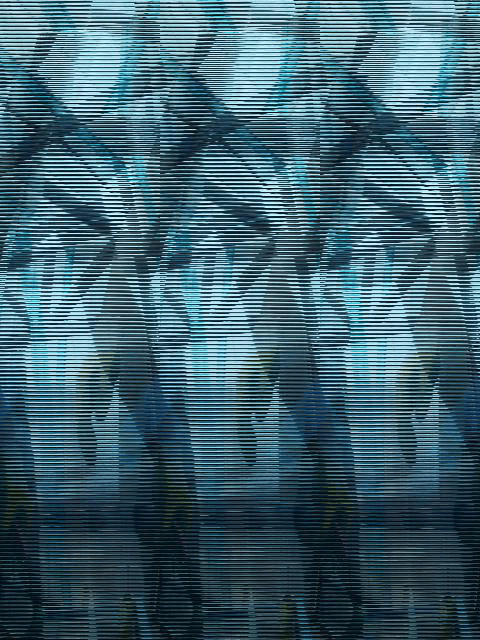

In [ ]:
imageio.plugins.freeimage.download()

anim_file = 'duckies_test.gif'

filenames = glob.glob('gif_frame_*.jpg')
filenames = sorted(filenames)
last = -1
images = []
for filename in filenames:
  image = imageio.imread(filename)
  images.append(image)

imageio.mimsave(anim_file, images, 'GIF-FI', fps=5)

display(IPyImage(open(anim_file, 'rb').read()))